In [2]:
import matplotlib.pyplot as plt
import scienceplots
from tbparse import SummaryReader

plt.style.use('science')
plt.rcParams['figure.dpi'] = 300
plt.rcParams["figure.figsize"] = (14,6)
plt.rcParams.update({'font.size': 18})

In [2]:
def plot(run_name, run_type, window=100):
    run_string = "Baseline" if run_type == "baseline" else "Federation"

    reader = SummaryReader(f"runs/{run_name}/", extra_columns=set(["dir_name"]))
    df = reader.scalars
    global_loss = df[df.tag == f"{run_type}/loss/global"][["step", "value"]]
    client_ids = sorted(list(set([x for x in map(lambda x: x.split("clients")[-1][1], df.tag.unique()) if x.isdigit()])))
    batch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/batch"][["step", "value"]] for client_id in client_ids]
    epoch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/epoch"][["step", "value", "tag", "dir_name"]] for client_id in client_ids]
    reader = SummaryReader(f"runs/TEST_40/", extra_columns=set(["dir_name"]))
    df_central = reader.scalars
    central_validation_loss = df_central[df_central.dir_name == "centralised_loss_epoch_validation"][["step", "value"]]
    central_batch_loss = df_central[df_central.tag == "centralised/loss/batch"][["step", "value"]][:10000]
    central_batch_rolling = central_batch_loss["value"].rolling(window=100, min_periods=1).mean().values

    # PLOT BATCH LOSS FOR EACH CLIENT
    for batch_loss, id in zip(batch_losses, client_ids):
        rolling = batch_loss["value"].rolling(window=window, min_periods=1).mean().values
        plt.plot(batch_loss["step"], rolling, label=f"Client {id}")
    plt.plot(central_batch_loss["step"], central_batch_rolling, label=f"Centralised")
    plt.xlabel("Batch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"{run_string} Batch Loss, window={window}"), plt.grid()
    plt.show()
    # PLOT EPOCH TRAIN/VAL LOSS FOR EACH CLIENT
    for epoch_loss, id in zip(epoch_losses, client_ids):
        train_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "train"]
        val_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "validation"]
        plt.plot(train_loss["step"], train_loss["value"], label=f"Client {id} Train")
        plt.plot(val_loss["step"], val_loss["value"], label=f"Client {id} Validation", linestyle="--")
    plt.xlabel("Epoch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"{run_string} Epoch Loss"), plt.grid()
    plt.show()
    # PLOT GLOBAL VS CENTRALISED
    g_loss = global_loss[global_loss.step > 0]
    c_loss = central_validation_loss[:50]
    c_loss_step_scaled = [x/5 for x in c_loss["step"]]
    plt.plot(g_loss["step"], g_loss["value"], label=f"Global Model Validation Loss")
    plt.plot(c_loss_step_scaled, c_loss["value"], label=f"Centralised  Validation Loss")
    plt.xlabel("Global Round / Epoch * 5"), plt.ylabel("L1 Loss"), plt.legend(), plt.title("Federation Global Loss"), plt.grid()
    plt.show()

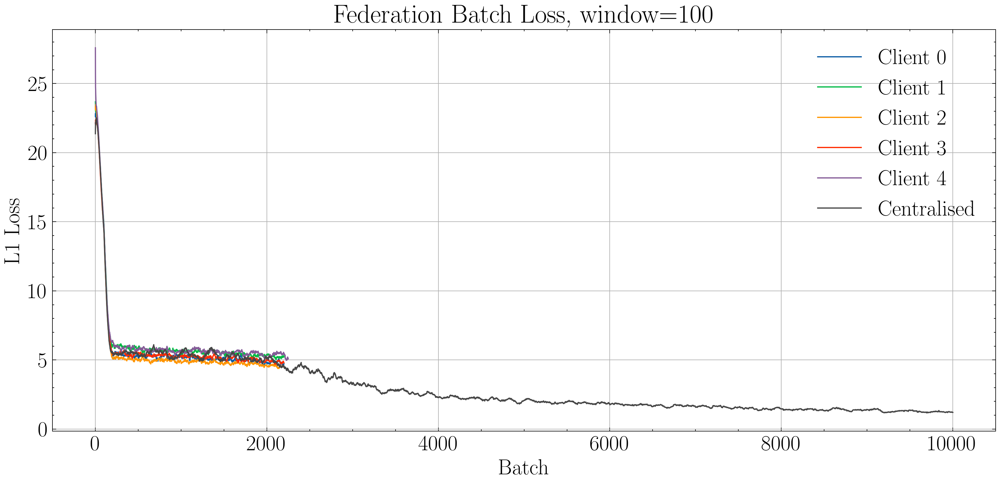

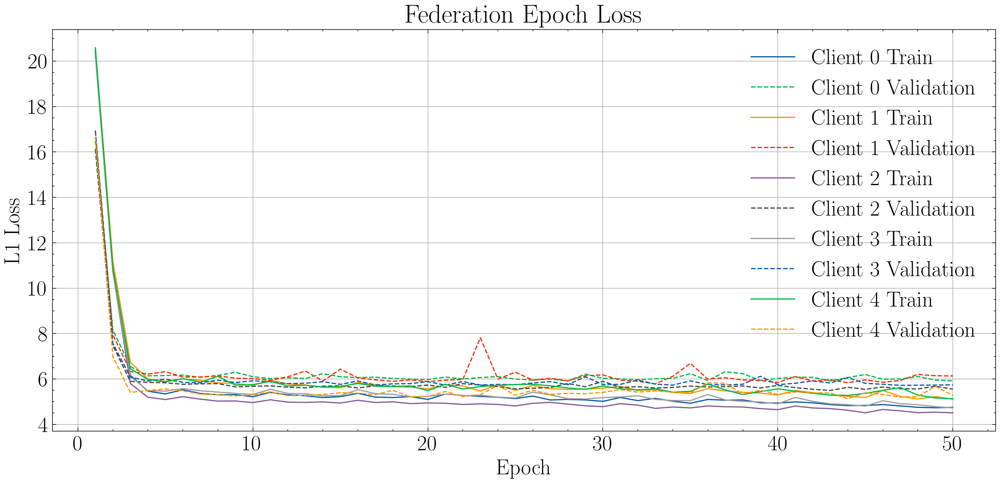

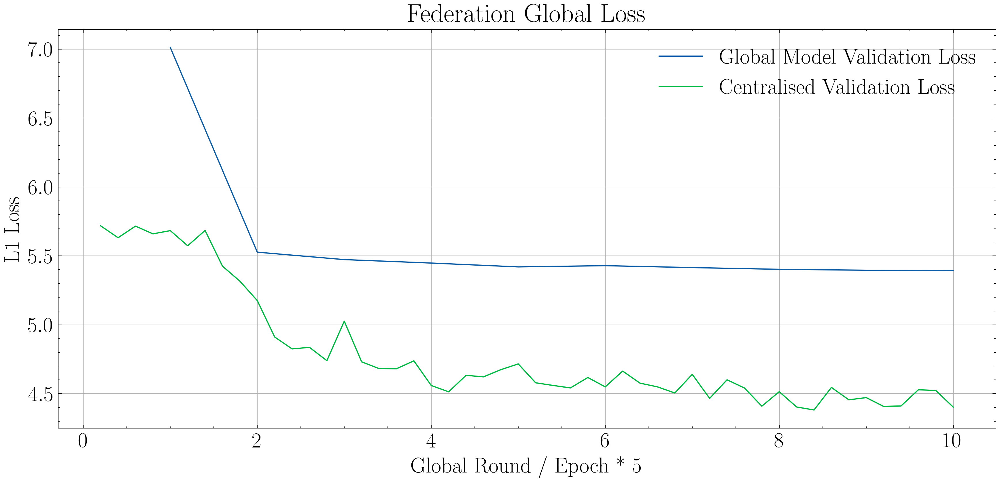

In [3]:
plot("FEDERATED_1", "federated", window=100)

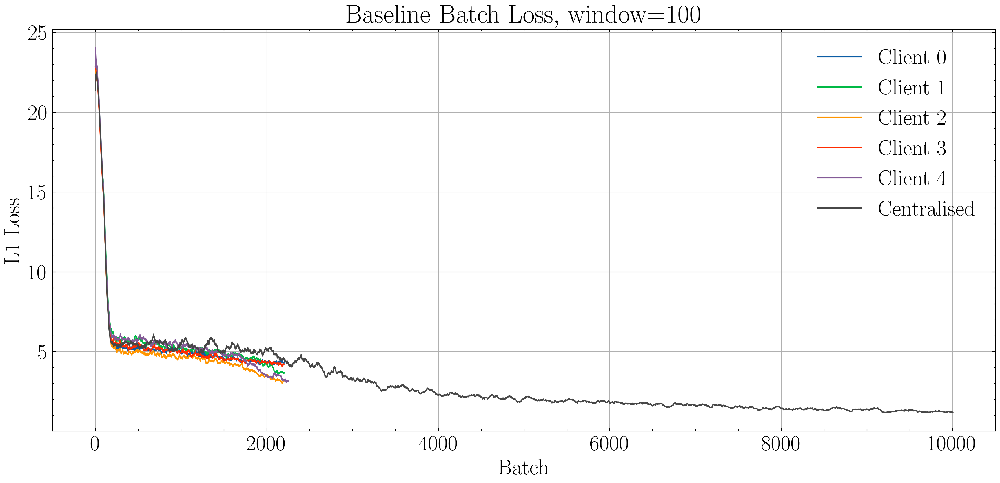

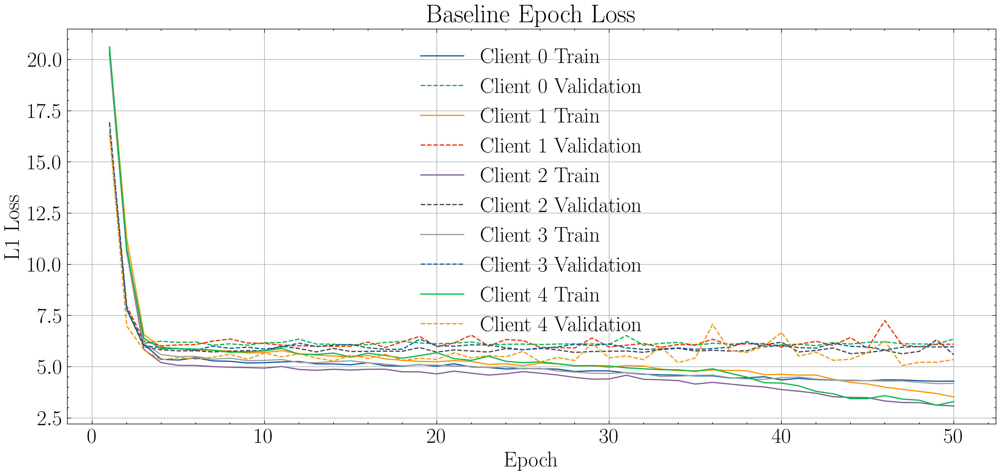

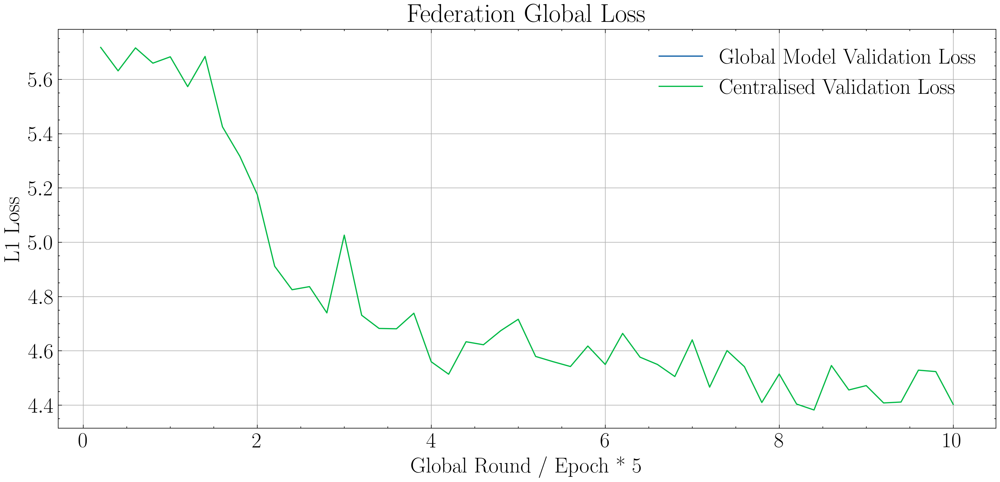

In [4]:
plot("BASELINE_1", "baseline", window=100)

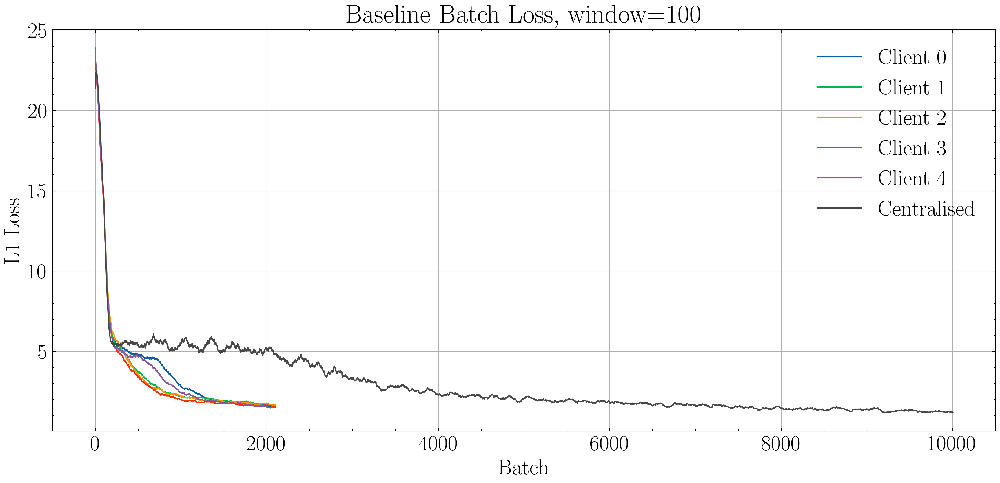

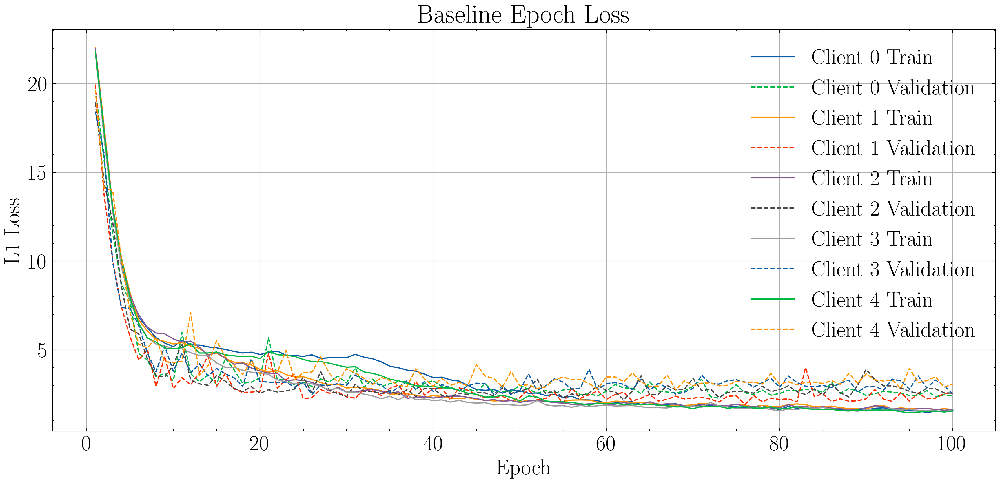

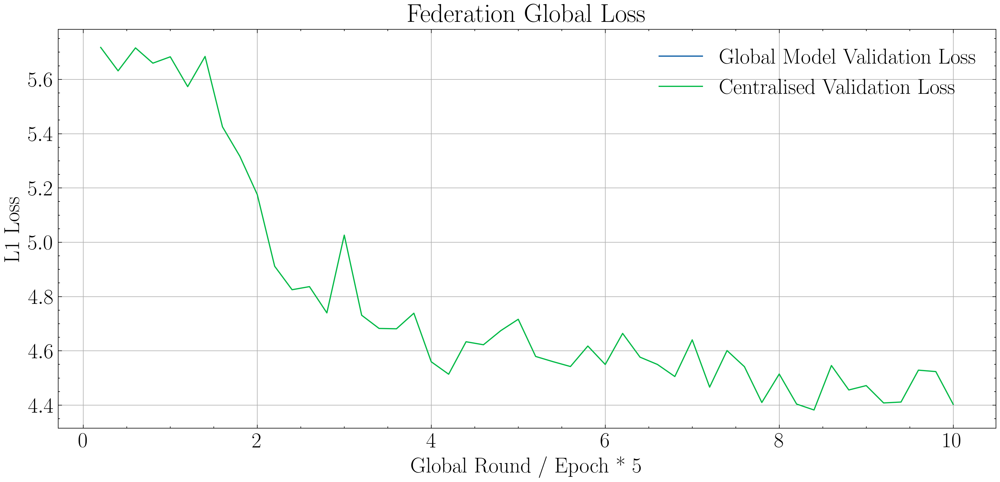

In [5]:
plot("BASELINE_2", "baseline", window=100)

/tmp/ipykernel_3446670/1416756244.py:21: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  bas_mean_baseline = df[df.run_type == "validation"].groupby("step").mean()["value"]


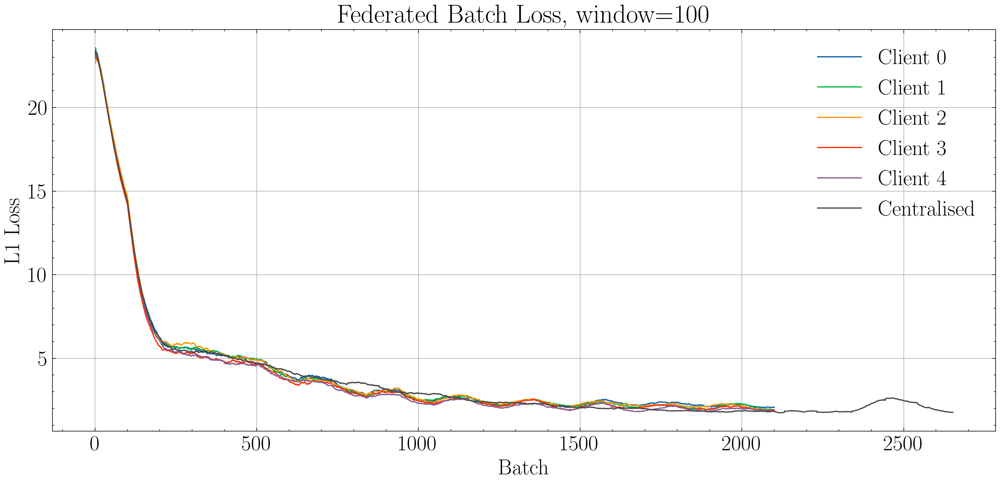

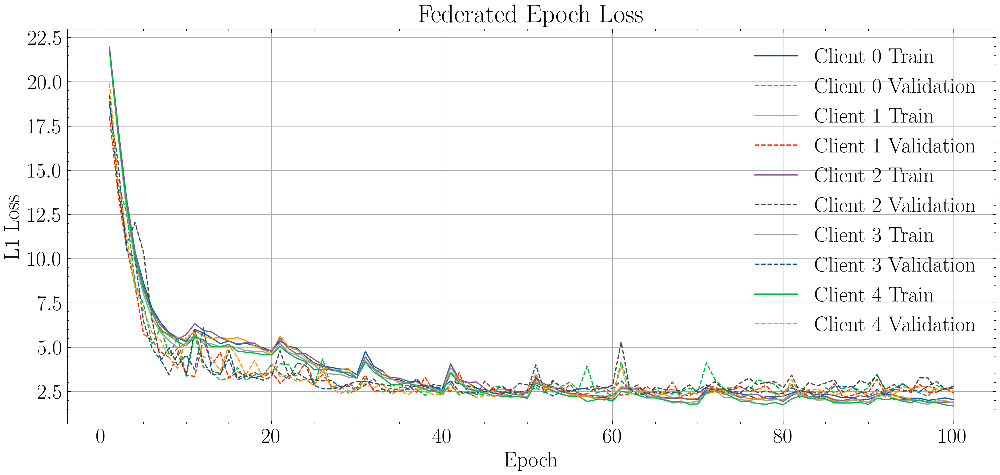

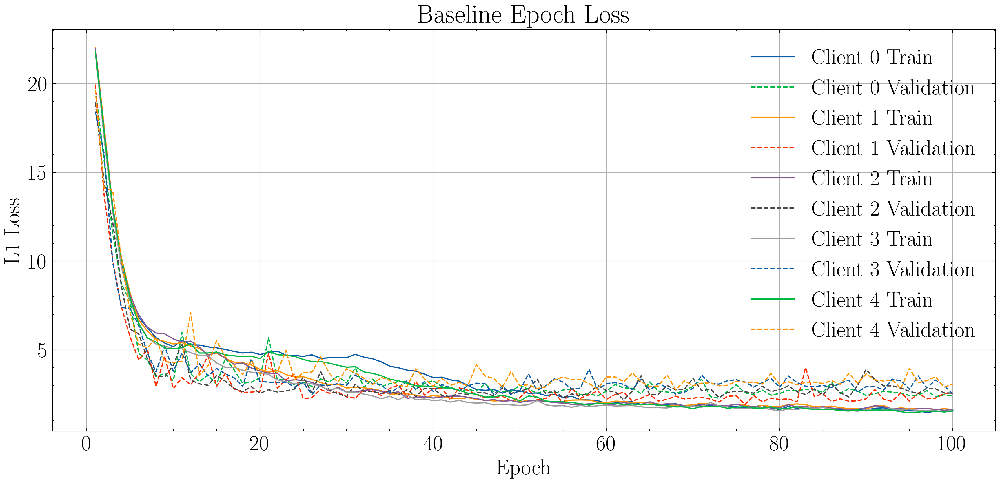

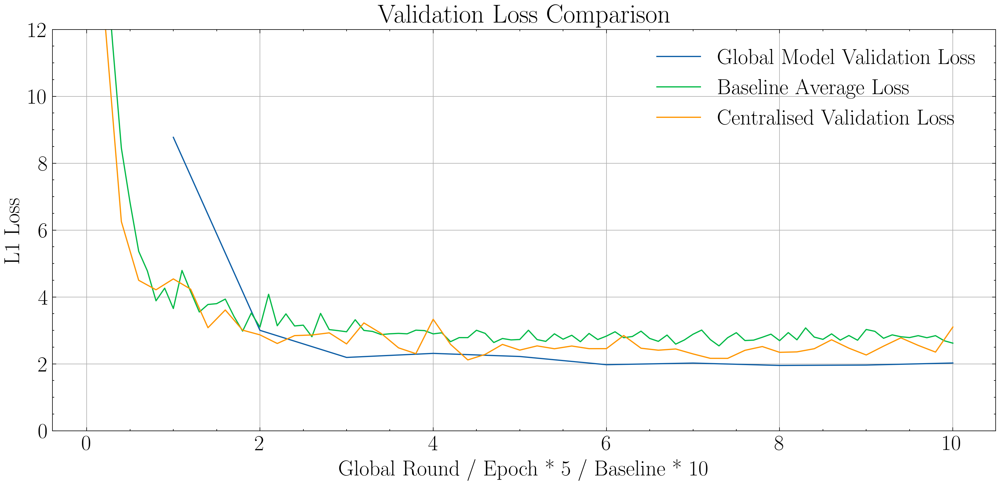

In [3]:
run_name_federated="FEDERATED_2"
run_name_baseline="BASELINE_2"
run_name_centralised="TEST_64"
window=100

# Federated
run_type="federated"
run_string = "Baseline" if run_type == "baseline" else "Federation"
reader = SummaryReader(f"runs/{run_name_federated}/", extra_columns=set(["dir_name"]))
df = reader.scalars
fed_global_loss = df[df.tag == f"{run_type}/loss/global"][["step", "value"]]
fed_client_ids = sorted(list(set([x for x in map(lambda x: x.split("clients")[-1][1], df.tag.unique()) if x.isdigit()])))
fed_batch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/batch"][["step", "value"]] for client_id in fed_client_ids]
fed_epoch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/epoch"][["step", "value", "tag", "dir_name"]] for client_id in fed_client_ids]
# Baseline
run_type="baseline"
run_string = "Baseline" if run_type == "baseline" else "Federation"
reader = SummaryReader(f"runs/{run_name_baseline}/", extra_columns=set(["dir_name"]))
df = reader.scalars
df["run_type"] = df.dir_name.apply(lambda x: x.split("_")[-1])
bas_mean_baseline = df[df.run_type == "validation"].groupby("step").mean()["value"]
bas_client_ids = sorted(list(set([x for x in map(lambda x: x.split("clients")[-1][1], df.tag.unique()) if x.isdigit()])))
bas_batch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/batch"][["step", "value"]] for client_id in bas_client_ids]
bas_epoch_losses = [df[df.tag == f"{run_type}/loss/clients/{client_id}/epoch"][["step", "value", "tag", "dir_name"]] for client_id in bas_client_ids]
# Centralised
reader = SummaryReader(f"runs/{run_name_centralised}/", extra_columns=set(["dir_name"]))
df_central = reader.scalars
central_validation_loss = df_central[df_central.dir_name == "centralised_loss_epoch_validation"][["step", "value"]]
central_batch_loss = df_central[df_central.tag == "centralised/loss/batch"][["step", "value"]][:10000]
central_batch_rolling = central_batch_loss["value"].rolling(window=100, min_periods=1).mean().values

# PLOT BATCH LOSS FOR EACH CLIENT
for batch_loss, id in zip(fed_batch_losses, fed_client_ids):
    rolling = batch_loss["value"].rolling(window=window, min_periods=1).mean().values
    plt.plot(batch_loss["step"], rolling, label=f"Client {id}")
plt.plot(central_batch_loss["step"], central_batch_rolling, label=f"Centralised")
plt.xlabel("Batch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"Federated Batch Loss, window={window}"), plt.grid()
plt.show()

# PLOT EPOCH TRAIN/VAL LOSS FOR EACH CLIENT
for epoch_loss, id in zip(fed_epoch_losses, fed_client_ids):
    train_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "train"]
    val_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "validation"]
    plt.plot(train_loss["step"], train_loss["value"], label=f"Client {id} Train")
    plt.plot(val_loss["step"], val_loss["value"], label=f"Client {id} Validation", linestyle="--")
plt.xlabel("Epoch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"Federated Epoch Loss"), plt.grid()
plt.savefig("plots/epoch_train_val.pdf"); plt.show()

# PLOT EPOCH TRAIN/VAL LOSS FOR EACH CLIENT (BASELINE)
for epoch_loss, id in zip(bas_epoch_losses, bas_client_ids):
    train_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "train"]
    val_loss = epoch_loss[epoch_loss.dir_name.apply(lambda x: x.split("_")[-1]) == "validation"]
    plt.plot(train_loss["step"], train_loss["value"], label=f"Client {id} Train")
    plt.plot(val_loss["step"], val_loss["value"], label=f"Client {id} Validation", linestyle="--")
plt.xlabel("Epoch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"Baseline Epoch Loss"), plt.grid()
plt.savefig("plots/epoch_train_val_baseline.pdf"); plt.show()

# PLOT GLOBAL VS CENTRALISED
g_loss = fed_global_loss[fed_global_loss.step > 0]
c_loss = central_validation_loss[:50]
c_loss_step_scaled = [x/5 for x in c_loss["step"]]
bas_step_scaled = [x/10 for x in bas_mean_baseline.index]

# PLOT THE MIN LOSS FOR EACH METHOD
min_fed_loss = g_loss.value.min()
min_central_loss = c_loss.value.min()
min_bas_loss = bas_mean_baseline.min()

# Add vertical lines for min loss
plt.plot(g_loss["step"], g_loss["value"], label=f"Global Model Validation Loss")
plt.plot(bas_step_scaled, bas_mean_baseline.values, label=f"Baseline Average Loss")
plt.plot(c_loss_step_scaled, c_loss["value"], label=f"Centralised  Validation Loss")
plt.xlabel("Global Round / Epoch * 5 / Baseline * 10"), plt.ylabel("L1 Loss"), plt.legend(), plt.title("Validation Loss Comparison"), plt.grid()
plt.ylim(0, 12); plt.savefig("plots/loss_comparison.pdf"); plt.show()

In [5]:
# plot the min losses
print(f"MinFedLoss: {min_fed_loss}, MinCentralLoss: {min_central_loss}, MinBaselineLoss: {min_bas_loss}")

MinFedLoss: 1.9533194303512573, MinCentralLoss: 2.118772029876709, MinBaselineLoss: 2.5386982440948485


In [7]:
import json
from fedswarm import Platform
from fedswarm.utils.data.utils.oxts import plot_predictions, present_predictions, visualize_car_points
from fedswarm.utils.models.model_manager import load_model_from_checkpoint

# plt config
plt.style.use('science')
plt.rcParams['figure.dpi'] = 300
plt.rcParams["figure.figsize"] = (16,4)
plt.rcParams.update({'font.size': 8})

with open("runs/TEST_64/config.json") as f:
    config = json.load(f)
cmodel = load_model_from_checkpoint("runs/TEST_28/centralised_mobilenet.pth", config)

# load the platform with the config
platform = Platform(config, data_only=True)

with open("runs/FEDERATED_2/config.json") as f:
    config = json.load(f)
fmodel = load_model_from_checkpoint("runs/FEDERATED_2/federated_mobilenet_8.pth", config)

with open("runs/BASELINE_2/config.json") as f:
    config = json.load(f)
bmodel = load_model_from_checkpoint("runs/BASELINE_2/best_model_client_3.pth", config)

Same run already exists, skipping run but creates platform
Run found in TEST_64


Loading train frames:   0%|          | 0/89976 [00:00<?, ?it/s]

Loading val frames:   0%|          | 0/10024 [00:00<?, ?it/s]

In [8]:
import matplotlib.pyplot as plt
import torch
import numpy as np

def present_predictions_v2(img, ground_truth, outputs, show=True, save=False, dataset=None, idx=None):
    fig, ax = plt.subplots()
    
    # Display the image
    ax.imshow(img)
    ax.set_title("Camera view")
    ax.axis("off")
    
    # Define location and dimensions of the inset plot
    left, bottom, width, height = [0.37, 0.6, 0.285, 0.22]  # adjust these values to fit your needs

    # Create inset plot
    ax2 = fig.add_axes([left, bottom, width, height])
    
    losses = []
    titles = ["Ground Truth", "Centralised Prediction", "Federated Prediction", "Baseline Prediction"]
    
    # Plot on inset axes
    ax2.scatter(x=ground_truth[:, 1], y=ground_truth[:, 0], s=1, c="blue")
    for i, (output, colour) in enumerate(zip(outputs, ["red", "lime", "yellow"])):
        ax2.scatter(x=output[:, 1], y=output[:, 0], s=1, c=colour)
        loss = torch.nn.L1Loss()(torch.tensor(output).squeeze(), torch.tensor(ground_truth))
        # Add the loss and corresponding label to the lists
        losses.append(loss.item())
        titles[i+1] = f"{titles[i+1]}, L1: {loss.item():.2f}"
    largest_x = max(abs(min(ground_truth[:, 1])), abs(max(ground_truth[:, 1])))
    x_threshold = 20
    lower_x_limit = -max(largest_x, x_threshold)
    upper_x_limit = max(largest_x, x_threshold)
    ax2.set_xlim(upper_x_limit, lower_x_limit)
    ax2.legend(titles)
    ax2.set_title("Birds-eye view", loc='center')
    
    # Set the y-axis limits to start at (0,0)
    ax2.set_ylim(0, ax2.get_ylim()[1])
    
    # Move the y-axis to the middle
    ax2.spines['left'].set_position('center')
    ax2.spines['right'].set_position('center')
    ax2.spines['left'].set_linewidth(0.5)
    
    # Remove the top spine and ticks
    ax2.spines['top'].set_visible(False)
    ax2.tick_params(axis='x', which='both', top=False)
    
    # Add tick marks on both sides of the y-axis
    ax2.yaxis.set_ticks_position('both')
    ax2.tick_params(axis='y', which='both', direction='in', left=True, right=True)
    
    # Set more axis labels
    ax2.yaxis.set_major_locator(plt.MaxNLocator(6))  # Adjust the number of labels as per your requirement
    ax2.xaxis.set_major_locator(plt.MaxNLocator(6))  # Adjust the number of labels as per your requirement
    
    # Move the tick labels of the bottom spine slightly higher
    ax2.tick_params(axis='x', which='major', pad=-10)
    
    # Remove the zeros from the tick labels
    ax2.xaxis.set_major_formatter(plt.FuncFormatter(lambda value, _: '' if value == 0 else f'{value:g}'))
    ax2.yaxis.set_major_formatter(plt.FuncFormatter(lambda value, _: '' if value == 0 else f'{value:g}'))
    
    ax2.grid(alpha=0.2)
    if save:
        plt.savefig(f"plots/predictions_{idx}.pdf")
    if show:
        plt.show()
    

In [369]:
import matplotlib.gridspec as gridspec
import cv2

def present_predictions_v3(img, ground_truth, outputs, show=True, save=False, dataset=None, idx=None):
    fig = plt.figure(figsize=(10, 10))
    
    gs = gridspec.GridSpec(2, 2, height_ratios=[.4, 2])
    gs.update(left=0, right=1, bottom=0, top=0.6, wspace=0.2, hspace=0)
    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])
    ax2 = plt.subplot(gs[2:])
    
    losses = []
    titles = ["Ground Truth", "Centralised Prediction", "Federated Prediction", "Baseline Prediction"]

    # Bird's-eye view plot
    ax0.scatter(x=ground_truth[:, 1], y=ground_truth[:, 0], s=1, c="blue")
    for i, (output, colour) in enumerate(zip(outputs, ["red", "lime", "yellow"])):
        ax0.scatter(x=output[:, 1], y=output[:, 0], s=1, c=colour)
        loss = torch.nn.L1Loss()(torch.tensor(output).squeeze(), torch.tensor(ground_truth))
        losses.append(loss.item())
        titles[i+1] = f"{titles[i+1]}, L1: {loss.item():.2f}"
    largest_x = max(abs(min(ground_truth[:, 1])), abs(max(ground_truth[:, 1])))
    x_threshold = 20
    lower_x_limit = -max(largest_x, x_threshold)
    upper_x_limit = max(largest_x, x_threshold)
    ax0.set_xlim(upper_x_limit, lower_x_limit)
    ax0.set_title("Birds-eye view", loc='center')
    
    # Elevation plot
    ax1.scatter(x=ground_truth[:, 0], y=ground_truth[:, 2], s=1, c="blue")
    for i, (output, colour) in enumerate(zip(outputs, ["red", "lime", "yellow"])):
        ax1.scatter(x=output[:, 0], y=output[:, 2], s=1, c=colour)
    ax1.set_ylim(-15, 15)
    ax1.set_title("Elevation view", loc='center')
    
    # Display the image
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img_height, img_width = img.shape[:2]

    # Define the rectangle to contain the labels and losses
    upper_left = (int(img_width / 8), int(img_height / 30))
    bottom_right = (int(img_width * 7 / 8), 150)
    cv2.rectangle(img, upper_left, bottom_right, (255, 255, 255), -1)

    # Define the color of each label's rectangle
    colors_bgr = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (0, 255, 255)]  # blue, red, lime, yellow in BGR

    # Horizontal spacing between labels
    spacing = (img_width-300) // (len(titles) + 1)

    # Define rectangle dimensions
    rect_height = 40
    rect_width = rect_height  # Keep width and height the same

    for i, title in enumerate(titles):
        # Define the upper left and bottom right points for each label's rectangle
        rect_x = [spacing, int(spacing//1.25) * 2, int(spacing//1.25) * 2 + spacing, int(spacing//1.25) * 2 + 2 * spacing][i]
        rect_y = int(img_height / 25)  # Place rectangle in the center of white box
        rec_upper_left = (rect_x, rect_y)
        rec_bottom_right = (rect_x + rect_width, rect_y + rect_height)
        cv2.rectangle(img, rec_upper_left, rec_bottom_right, colors_bgr[i], -1)

        # Positioning the text to the right of its corresponding rectangle
        text_position = (rect_x + rect_width + 10, int(img_height / 18))  # The 10 is arbitrary padding
        cv2.putText(img, title, text_position, cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 0, 0), 4)

    # frame for frame id
    upper_left = (int(img_width * 4 / 9), int(img_height / 12))
    bottom_right = (int(img_width * 5 / 9), int(img_height / 12 + 70))
    cv2.rectangle(img, upper_left, bottom_right, (255, 255, 255), -1)
    cv2.putText(img, f"Frame {idx}", (int(img_width * 4 / 9) + 80, int(img_height / 12) + 50), cv2.FONT_HERSHEY_SIMPLEX, 1.25, (0, 0, 0), 4)
    
    ax2.imshow(cv2.cvtColor(img[:1650,:,:], cv2.COLOR_BGR2RGB))
    ax2.set_title("Camera view")
    ax2.axis("off")


    if save:
        plt.savefig(f"plots/predictions_{idx}.pdf")
    if show:
        plt.show()


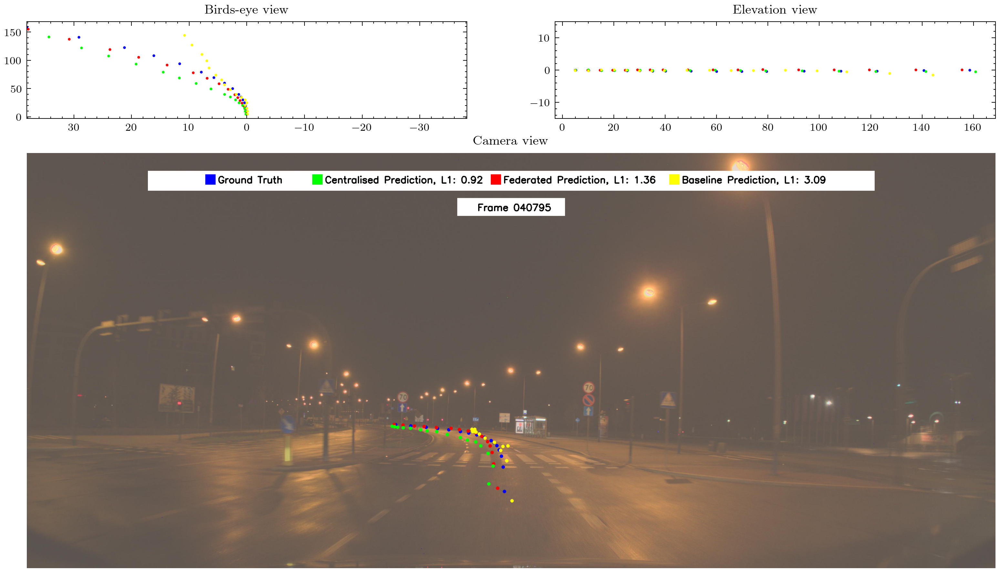

In [380]:
i = 30

# fetch the dataset
zod_frames = platform.data.zod_frames
dataset = platform.data.central.val.dataset

img, label = dataset[i]
frame_id = dataset.frames_id_set[i]
with torch.no_grad():
    # Pass the input through the model to get the output
    coutput = cmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()
    foutput = fmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()
    boutput = bmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()

img_original = np.ascontiguousarray(zod_frames[(dataset.frames_id_set[0])].get_image().transpose(2,1,0))
image = visualize_car_points(zod_frames, frame_id, label.reshape(17,3), colour=(0, 0, 255))
image = visualize_car_points(zod_frames, frame_id, coutput, colour=(255, 0, 0), image=image)
image = visualize_car_points(zod_frames, frame_id, foutput, colour=(0, 255, 0), image=image)
image = visualize_car_points(zod_frames, frame_id, boutput, colour=(255, 255, 0), image=image)

present_predictions_v3(image, label.reshape(17,3), [coutput, foutput, boutput], idx=frame_id)

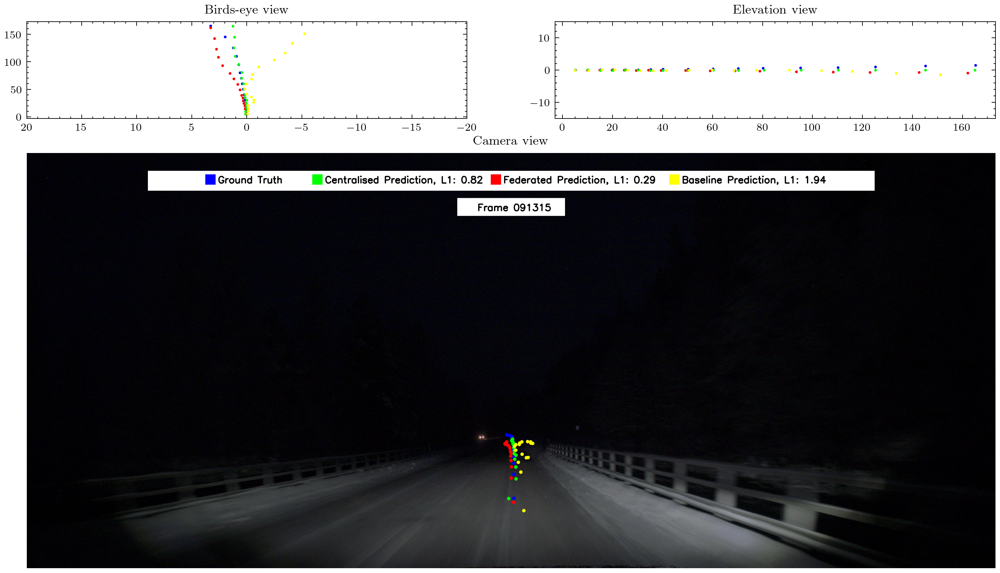

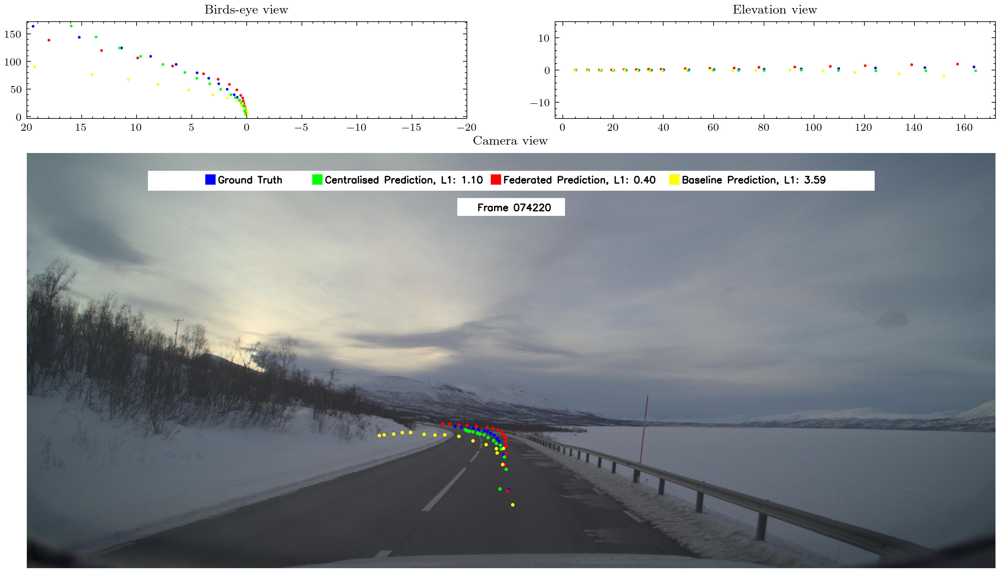

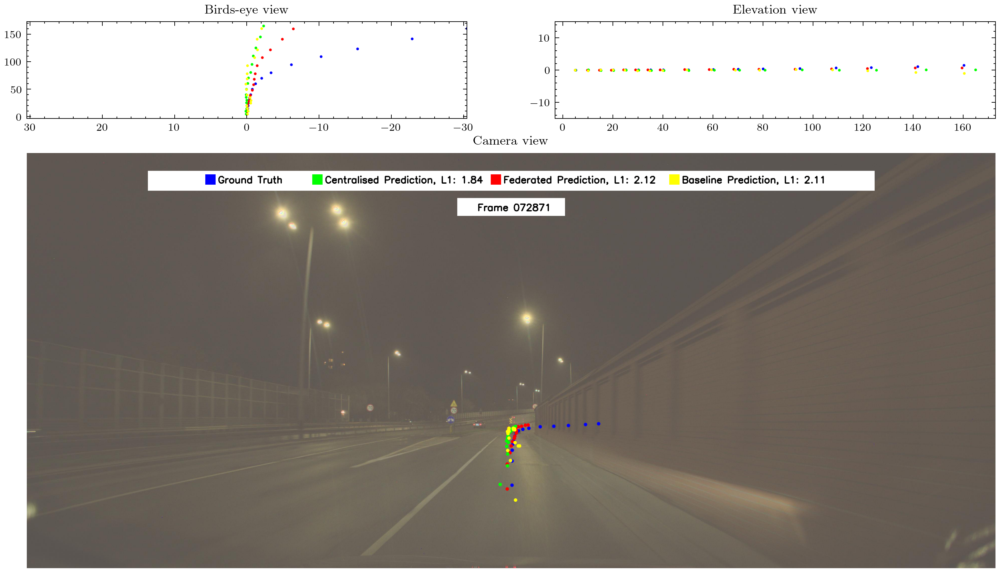

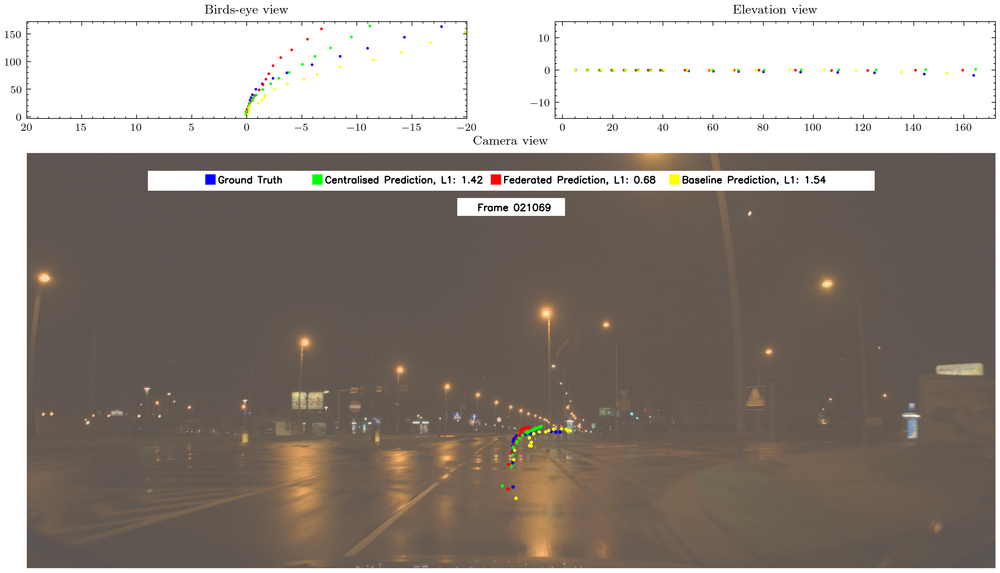

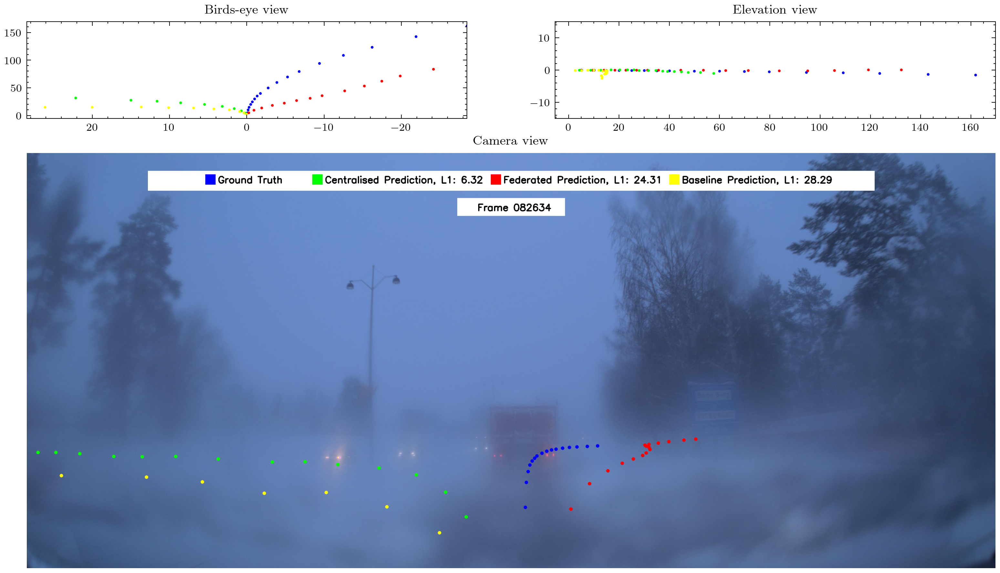

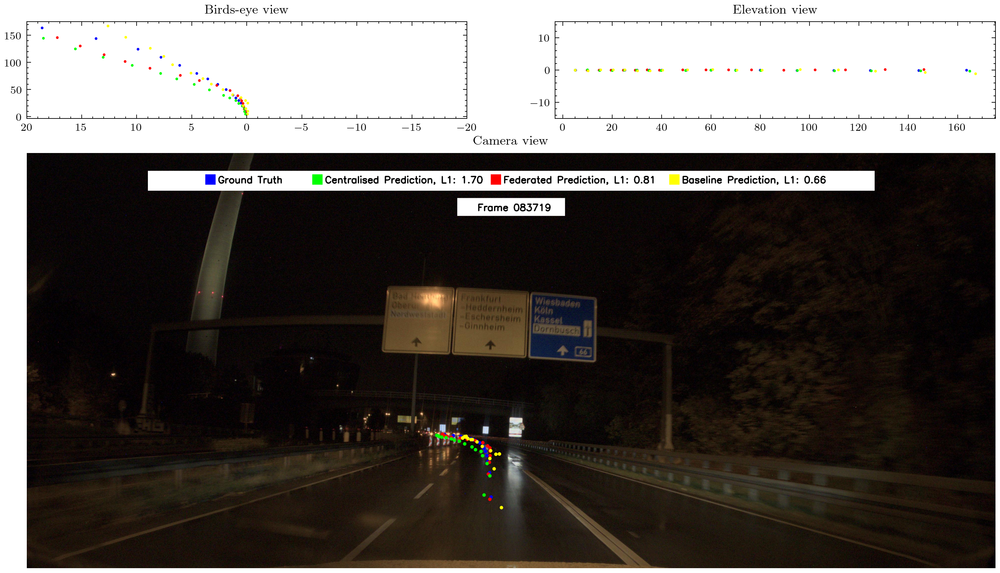

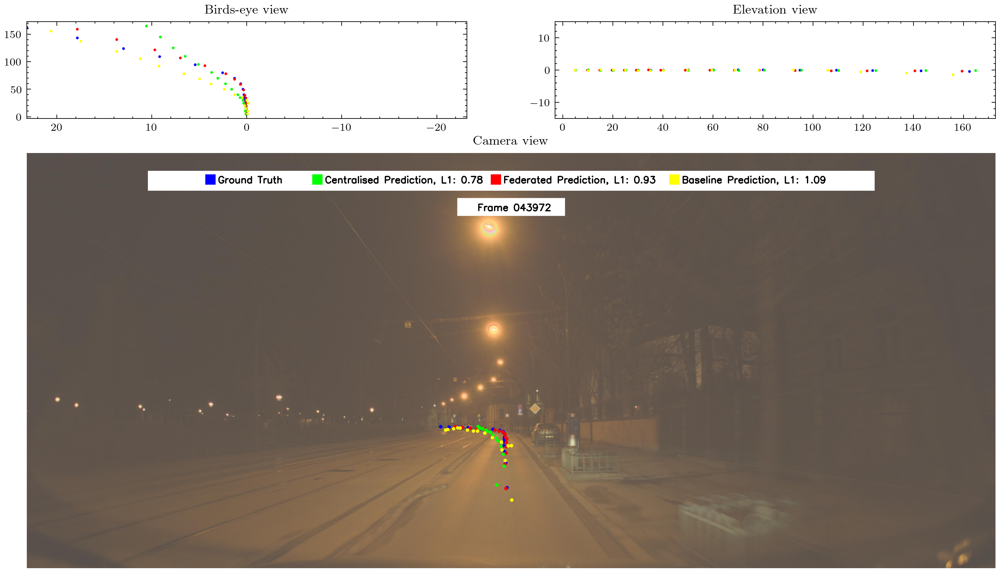

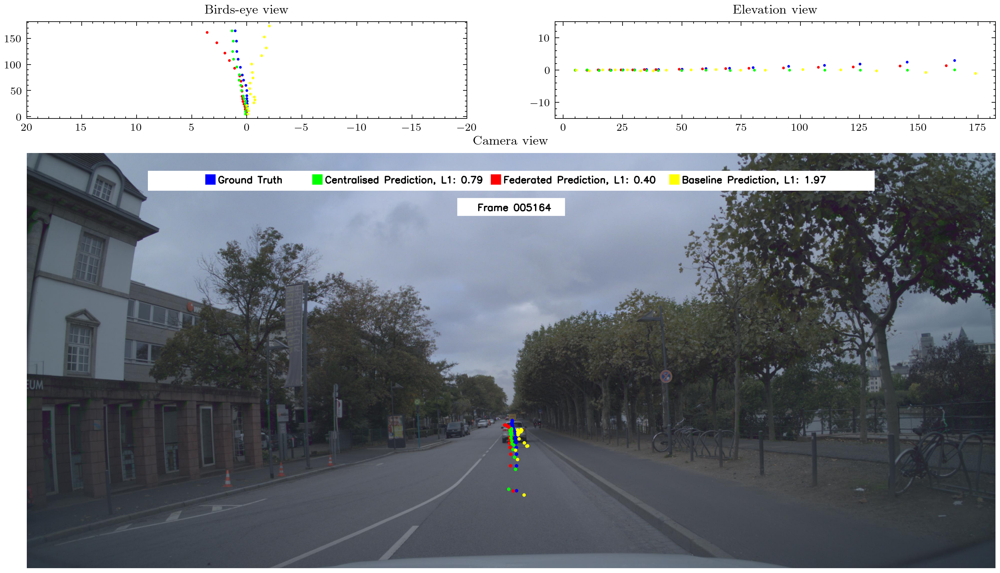

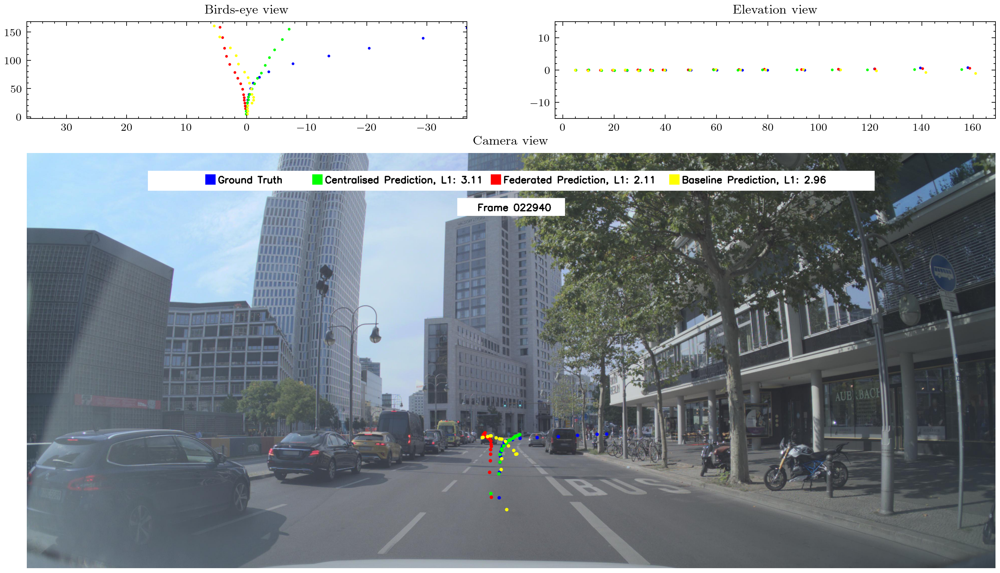

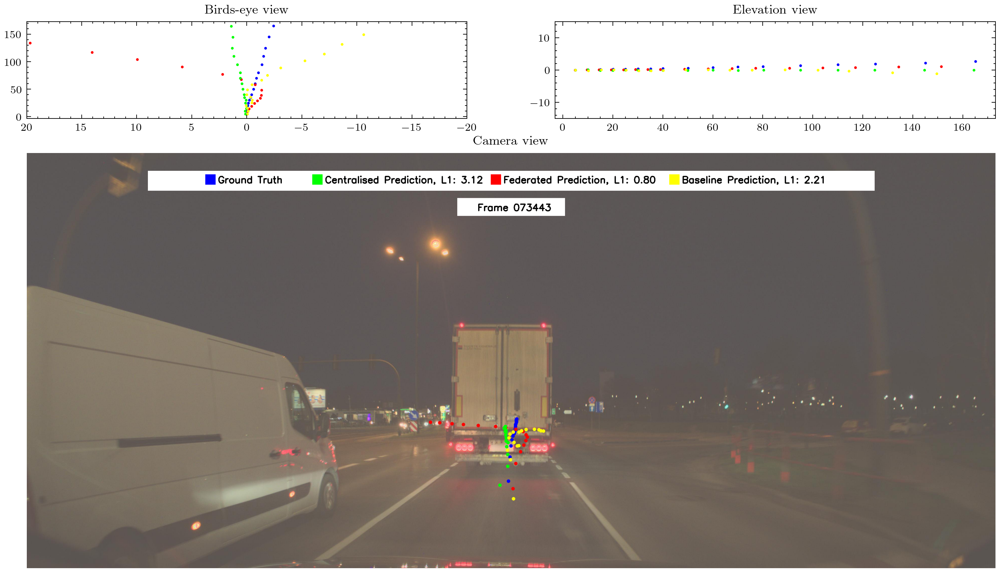

In [379]:
i = 30

# fetch the dataset
zod_frames = platform.data.zod_frames
dataset = platform.data.central.val.dataset

# 26, 30, 42
import random
samples = random.sample(range(len(dataset)), 100)

for i in samples:
    img, label = dataset[i]
    frame_id = dataset.frames_id_set[i]
    with torch.no_grad():
        # Pass the input through the model to get the output
        coutput = cmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()
        foutput = fmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()
        boutput = bmodel(img.expand(size=(1,3,256,256)).cuda()).cpu().numpy().squeeze()

    img_original = np.ascontiguousarray(zod_frames[(dataset.frames_id_set[0])].get_image().transpose(2,1,0))
    image = visualize_car_points(zod_frames, frame_id, label.reshape(17,3), colour=(0, 0, 255))
    image = visualize_car_points(zod_frames, frame_id, coutput, colour=(255, 0, 0), image=image)
    image = visualize_car_points(zod_frames, frame_id, foutput, colour=(0, 255, 0), image=image)
    image = visualize_car_points(zod_frames, frame_id, boutput, colour=(255, 255, 0), image=image)

    present_predictions_v3(image, label.reshape(17,3), [coutput, foutput, boutput], idx=frame_id, save=True)

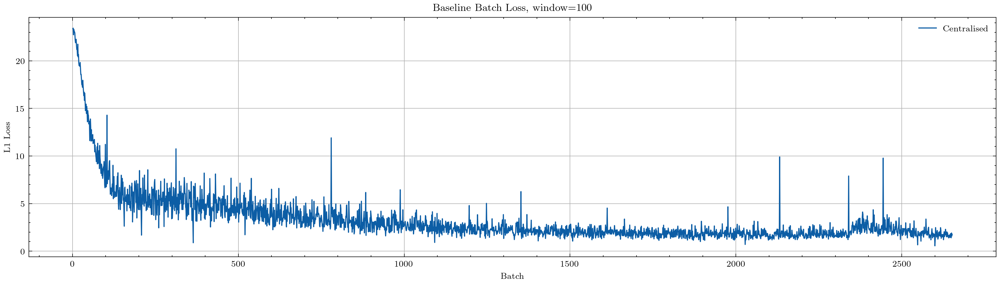

In [219]:
reader = SummaryReader(f"runs/TEST_64/", extra_columns=set(["dir_name"]))
df = reader.scalars
central_batch_loss = df_central[df_central.tag == "centralised/loss/batch"][["step", "value"]][:10000]
central_batch_rolling = central_batch_loss["value"].rolling(window=100, min_periods=1).mean().values

# PLOT BATCH LOSS FOR EACH CLIENT
plt.plot(central_batch_loss["step"], central_batch_loss["value"], label=f"Centralised")
plt.xlabel("Batch"), plt.ylabel("L1 Loss"), plt.legend(), plt.title(f"{run_string} Batch Loss, window={window}"), plt.grid()
plt.show()